In [ ]:
import sys
# can't relative import with sister directory
sys.path.insert(0, "..")
from ai2es import config
import pandas as pd
from datetime import datetime
import os
import numpy as np
from pathlib import Path
from dataclasses import dataclass
import time
import cv2
from matplotlib import pyplot as plt
from skimage.exposure import is_low_contrast

['ADDI' 'ANDE' 'BATA' 'BEAC' 'BELD' 'BELL' 'BELM' 'BERK' 'BING' 'BKLN'
 'BRAN' 'BREW' 'BROC' 'BRON' 'BROO' 'BSPA' 'BUFF' 'BURD' 'BURT' 'CAMD'
 'CAPE' 'CHAZ' 'CHES' 'CINC' 'CLAR' 'CLIF' 'CLYM' 'COBL' 'COHO' 'COLD'
 'COPA' 'COPE' 'CROG' 'CSQR' 'DELE' 'DEPO' 'DOVE' 'DUAN' 'EAUR' 'EDIN'
 'EDWA' 'ELDR' 'ELLE' 'ELMI' 'ESSX' 'FAYE' 'FRED' 'GABR' 'GFAL' 'GFLD'
 'GROT' 'GROV' 'HAMM' 'HARP' 'HARR' 'HART' 'HERK' 'HFAL' 'ILAK' 'JOHN'
 'JORD' 'KIND' 'LAUR' 'LOUI' 'MALO' 'MANH' 'MEDI' 'MEDU' 'MORR' 'NBRA'
 'NEWC' 'NHUD' 'OLDF' 'OLEA' 'ONTA' 'OPPE' 'OSCE' 'OSWE' 'OTIS' 'OWEG'
 'PENN' 'PHIL' 'PISE' 'POTS' 'QUEE' 'RAND' 'RAQU' 'REDF' 'REDH' 'ROXB'
 'RUSH' 'SARA' 'SBRI' 'SCHA' 'SCHO' 'SCHU' 'SCIP' 'SHER' 'SOME' 'SOUT'
 'SPRA' 'SPRI' 'STAT' 'STEP' 'SUFF' 'TANN' 'TICO' 'TULL' 'TUPP' 'TYRO'
 'VOOR' 'WALL' 'WALT' 'WANT' 'WARS' 'WARW' 'WATE' 'WBOU' 'WELL' 'WEST'
 'WFMB' 'WGAT' 'WHIT' 'WOLC' 'YORK']

In [3]:
def camera_photo_paths(photo_dir: str = "../cam_photos") -> None:
    """create dataframe of camera images including station ids, paths, and datetimes

    Args:
        photo_dir (str, optional): directory of camera photos. Defaults to "../cam_photos".
    """
    photo_files = os.listdir(photo_dir)
    stations = [photo.split("_")[1].split(".")[0] for photo in photo_files]
    dates = [
        datetime.strptime(photo.split("_")[0].replace("T", ""), "%Y%m%d%H%M%S")
        for photo in photo_files
    ]
    camera_df = pd.DataFrame({"stid": stations, "datetime": dates})
    camera_df['year'] = camera_df["datetime"].dt.year
    print(camera_df.groupby('year').nunique())

camera_photo_paths()

count    1.648732e+06
mean     2.015925e+03
std      2.895974e-01
min      2.015000e+03
25%      2.016000e+03
50%      2.016000e+03
75%      2.016000e+03
max      2.017000e+03
Name: datetime, dtype: float64


In [24]:
df['precip_accum_1min [mm]'].describe()

count    7.579630e+06
mean     2.564561e-03
std      2.642053e-02
min      0.000000e+00
25%      0.000000e+00
50%      0.000000e+00
75%      0.000000e+00
max      4.970000e+00
Name: precip_accum_1min [mm], dtype: float64

In [27]:

def read_parquet(year):
    """read parquet file that has yearly df of images"""
    start_time = time.time()
    df = pd.read_parquet(f"/ai2es/matched_parquet/{str(year)}.parquet")
    
    #df = self.df[self.df["stid"] == 'MANH']
    df = df[df['precip_accum_1min [mm]'] > 0.5]
    print(len(df))
    return df

def time_of_day(df):
    """find if images were taken during the day or night"""
    night = []
    for index, img in enumerate(df["path"][:1000, 10]):
        print(index, img)
        image = cv2.imread(str(img))
        contrast = 'light' if np.mean(image) > 70 else 'dark'
        b, g, r = image[:, :, 0], image[:, :, 1], image[:, :, 2]
        if (b == g).all() and (b == r).all():
            print('night', contrast)
        else:
            print('day')
        plt.imshow(image)
        plt.show()


In [26]:
df = read_parquet(2017)

3169


0 /ai2es/cam_photos/2017/05/01/ADDI/20170501T221001_ADDI.jpg
day light


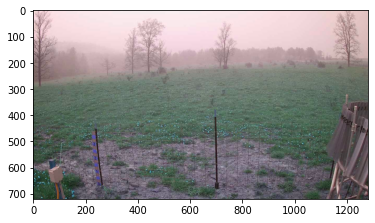

1 /ai2es/cam_photos/2017/05/01/ADDI/20170501T221501_ADDI.jpg
day light


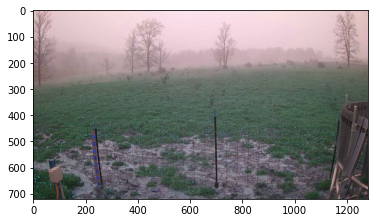

2 /ai2es/cam_photos/2017/05/06/ADDI/20170506T154002_ADDI.jpg
day light


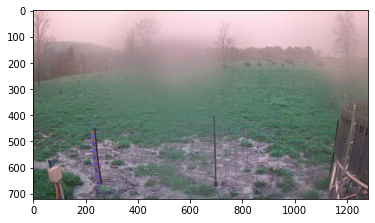

3 /ai2es/cam_photos/2017/05/30/ADDI/20170530T224002_ADDI.jpg
day light


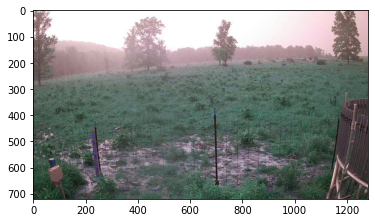

4 /ai2es/cam_photos/2017/05/30/ADDI/20170530T224501_ADDI.jpg
day light


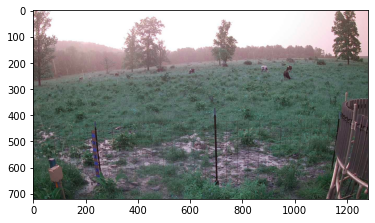

5 /ai2es/cam_photos/2017/06/13/ADDI/20170613T214526_ADDI.jpg
day light


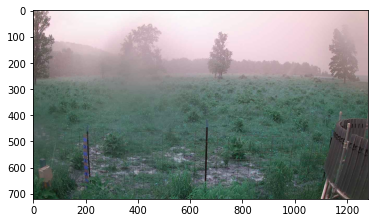

6 /ai2es/cam_photos/2017/06/18/ADDI/20170618T231526_ADDI.jpg
day light


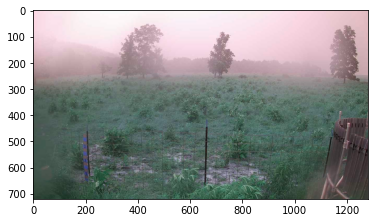

7 /ai2es/cam_photos/2017/07/01/ADDI/20170701T083026_ADDI.jpg
night light


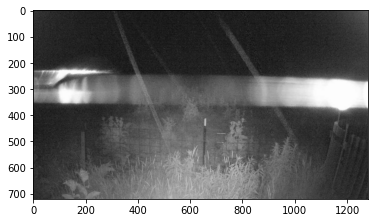

8 /ai2es/cam_photos/2017/07/01/ADDI/20170701T235527_ADDI.jpg
day light


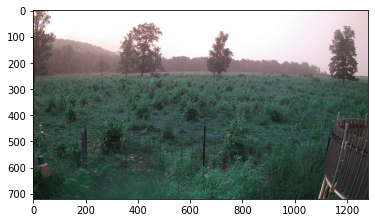

9 /ai2es/cam_photos/2017/07/17/ADDI/20170717T192026_ADDI.jpg
day light


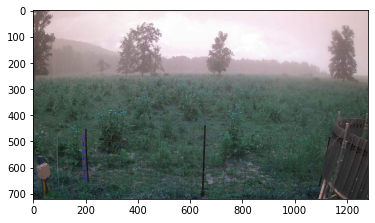

10 /ai2es/cam_photos/2017/07/17/ADDI/20170717T192527_ADDI.jpg
day light


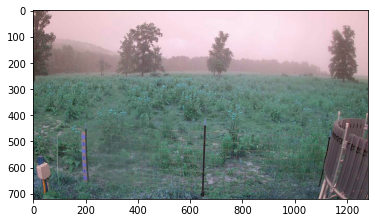

11 /ai2es/cam_photos/2017/07/20/ADDI/20170720T190527_ADDI.jpg
day light


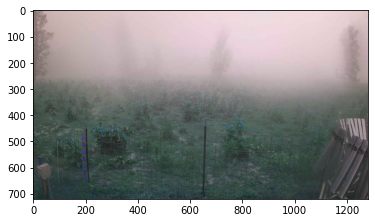

12 /ai2es/cam_photos/2017/07/20/ADDI/20170720T191026_ADDI.jpg
day light


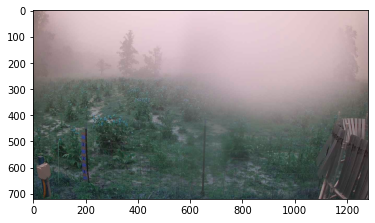

13 /ai2es/cam_photos/2017/07/20/ADDI/20170720T194526_ADDI.jpg
day light


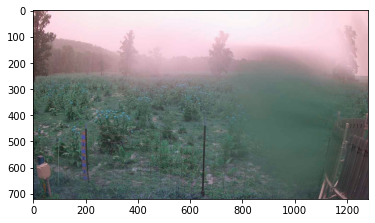

14 /ai2es/cam_photos/2017/08/01/ADDI/20170801T183026_ADDI.jpg
day light


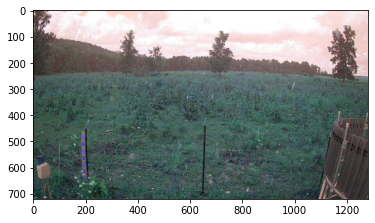

15 /ai2es/cam_photos/2017/08/01/ADDI/20170801T204527_ADDI.jpg
day light


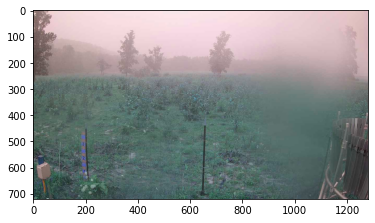

16 /ai2es/cam_photos/2017/08/01/ADDI/20170801T205026_ADDI.jpg
day light


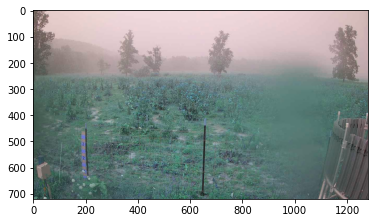

17 /ai2es/cam_photos/2017/08/01/ADDI/20170801T205526_ADDI.jpg
day light


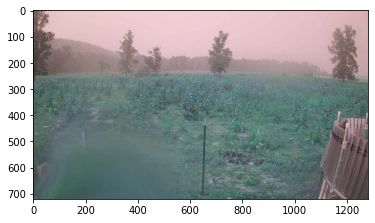

18 /ai2es/cam_photos/2017/08/02/ADDI/20170802T233526_ADDI.jpg
day light


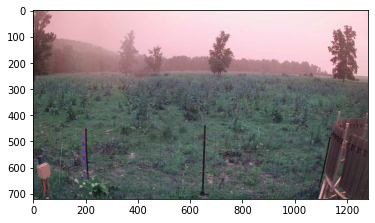

19 /ai2es/cam_photos/2017/08/05/ADDI/20170805T030026_ADDI.jpg
night dark


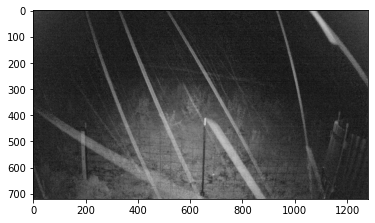

20 /ai2es/cam_photos/2017/08/18/ADDI/20170818T201027_ADDI.jpg
day light


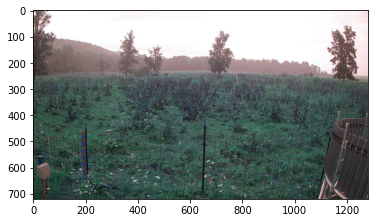

21 /ai2es/cam_photos/2017/02/25/ANDE/20170225T215001_ANDE.jpg
day light


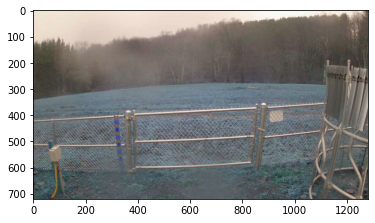

22 /ai2es/cam_photos/2017/04/16/ANDE/20170416T213001_ANDE.jpg
day light


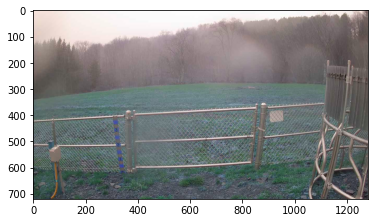

23 /ai2es/cam_photos/2017/05/02/ANDE/20170502T010502_ANDE.jpg
night light


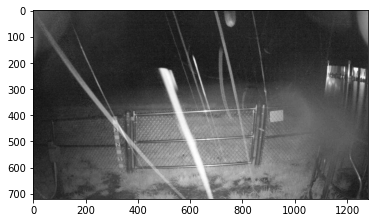

24 /ai2es/cam_photos/2017/05/19/ANDE/20170519T010502_ANDE.jpg
night light


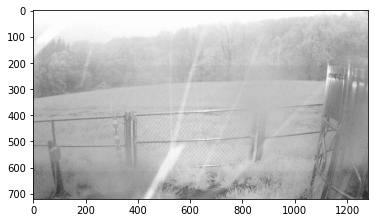

25 /ai2es/cam_photos/2017/06/05/ANDE/20170605T212527_ANDE.jpg
day light


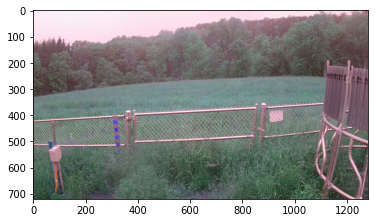

26 /ai2es/cam_photos/2017/06/05/ANDE/20170605T214026_ANDE.jpg
day light


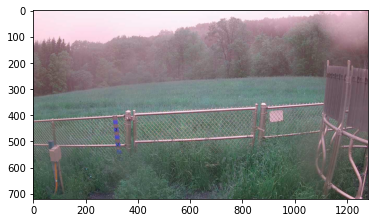

27 /ai2es/cam_photos/2017/06/05/ANDE/20170605T215026_ANDE.jpg
day light


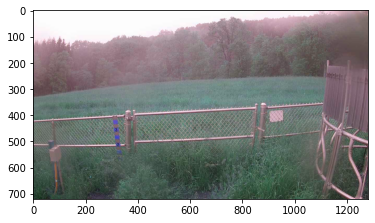

28 /ai2es/cam_photos/2017/06/19/ANDE/20170619T084026_ANDE.jpg
night light


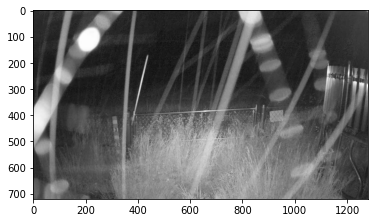

29 /ai2es/cam_photos/2017/06/19/ANDE/20170619T101527_ANDE.jpg
day light


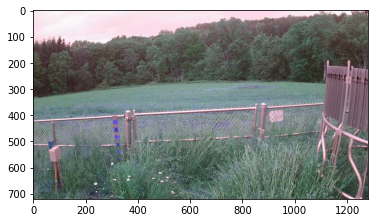

30 /ai2es/cam_photos/2017/06/19/ANDE/20170619T102527_ANDE.jpg
day light


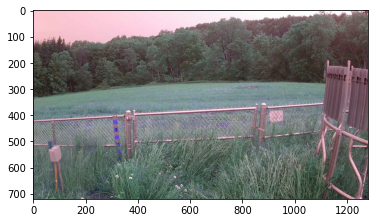

31 /ai2es/cam_photos/2017/06/27/ANDE/20170627T194027_ANDE.jpg
day light


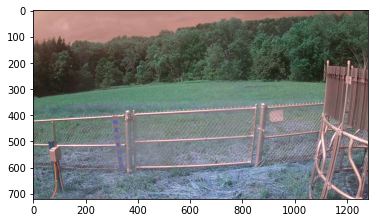

32 /ai2es/cam_photos/2017/06/30/ANDE/20170630T225027_ANDE.jpg
day light


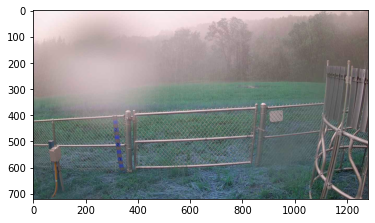

33 /ai2es/cam_photos/2017/06/30/ANDE/20170630T225526_ANDE.jpg
day light


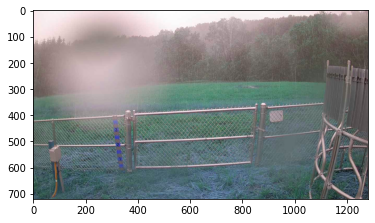

34 /ai2es/cam_photos/2017/06/30/ANDE/20170630T232027_ANDE.jpg
day light


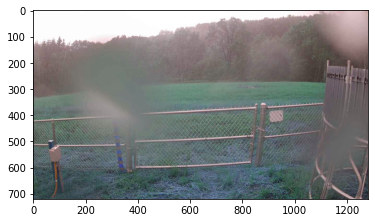

35 /ai2es/cam_photos/2017/07/12/ANDE/20170712T184027_ANDE.jpg
day light


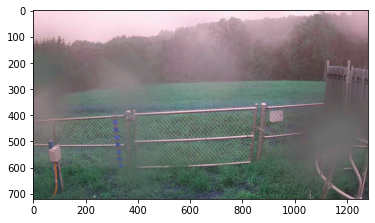

36 /ai2es/cam_photos/2017/07/12/ANDE/20170712T184526_ANDE.jpg
day light


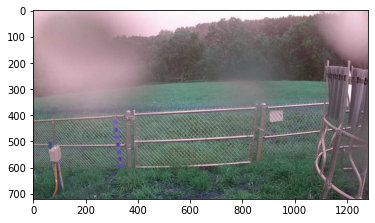

37 /ai2es/cam_photos/2017/07/12/ANDE/20170712T185026_ANDE.jpg
day light


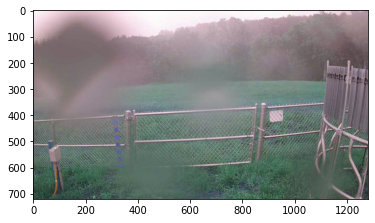

38 /ai2es/cam_photos/2017/07/12/ANDE/20170712T191027_ANDE.jpg
day light


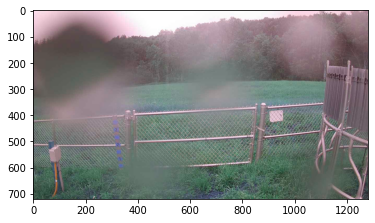

39 /ai2es/cam_photos/2017/08/18/ANDE/20170818T183027_ANDE.jpg
day light


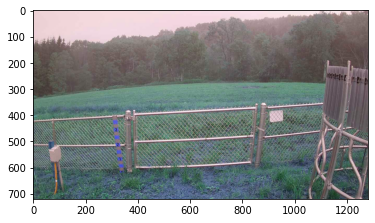

40 /ai2es/cam_photos/2017/08/18/ANDE/20170818T183526_ANDE.jpg
day light


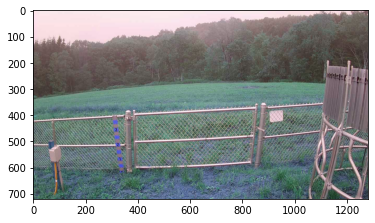

41 /ai2es/cam_photos/2017/08/20/ANDE/20170820T002026_ANDE.jpg
night light


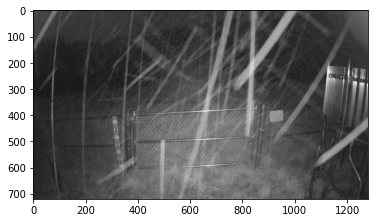

42 /ai2es/cam_photos/2017/10/24/ANDE/20171024T151527_ANDE.jpg
day light


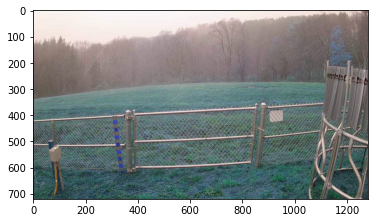

43 /ai2es/cam_photos/2017/10/24/ANDE/20171024T152526_ANDE.jpg
day light


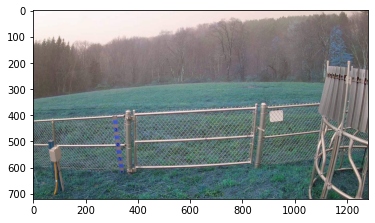

44 /ai2es/cam_photos/2017/10/24/ANDE/20171024T161026_ANDE.jpg
day light


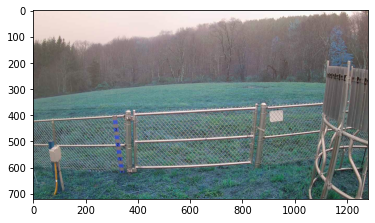

45 /ai2es/cam_photos/2017/10/30/ANDE/20171030T040026_ANDE.jpg
night light


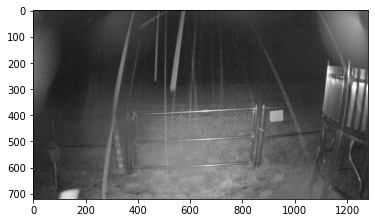

46 /ai2es/cam_photos/2017/04/20/BATA/20170420T224502_BATA.jpg
day light


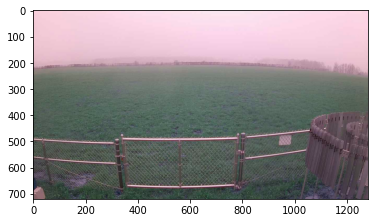

47 /ai2es/cam_photos/2017/04/21/BATA/20170421T004001_BATA.jpg
night light


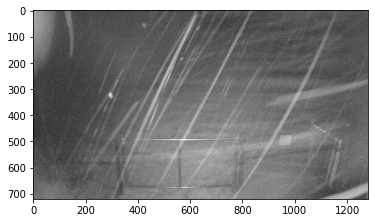

48 /ai2es/cam_photos/2017/05/01/BATA/20170501T202001_BATA.jpg
day light


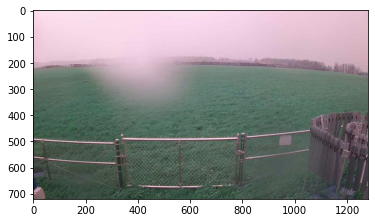

49 /ai2es/cam_photos/2017/06/15/BATA/20170615T133527_BATA.jpg
day light


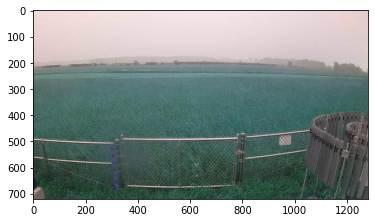

50 /ai2es/cam_photos/2017/06/15/BATA/20170615T135526_BATA.jpg
day light


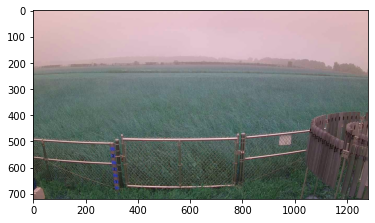

51 /ai2es/cam_photos/2017/06/15/BATA/20170615T140027_BATA.jpg
day light


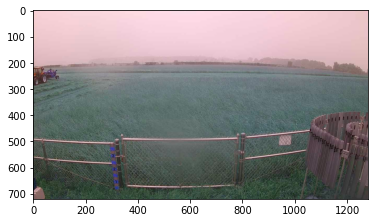

52 /ai2es/cam_photos/2017/06/15/BATA/20170615T141527_BATA.jpg
day light


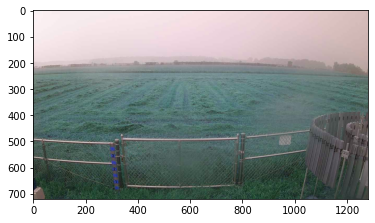

53 /ai2es/cam_photos/2017/06/25/BATA/20170625T001026_BATA.jpg
day light


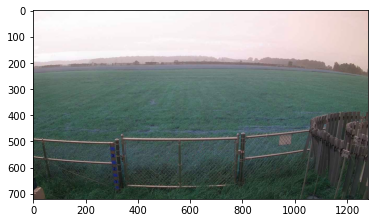

54 /ai2es/cam_photos/2017/06/25/BATA/20170625T001527_BATA.jpg
day light


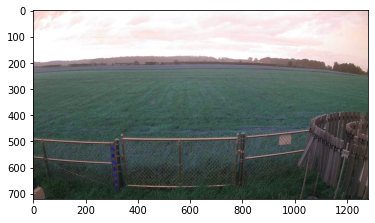

55 /ai2es/cam_photos/2017/07/12/BATA/20170712T133026_BATA.jpg
day light


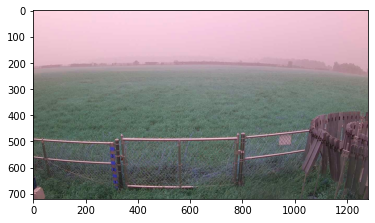

56 /ai2es/cam_photos/2017/07/12/BATA/20170712T133527_BATA.jpg
day light


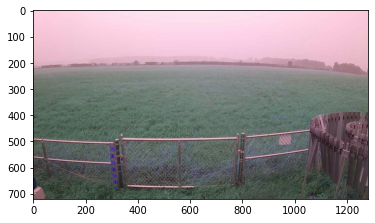

57 /ai2es/cam_photos/2017/07/12/BATA/20170712T144027_BATA.jpg
day light


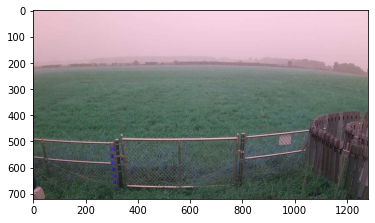

58 /ai2es/cam_photos/2017/07/13/BATA/20170713T142027_BATA.jpg
day light


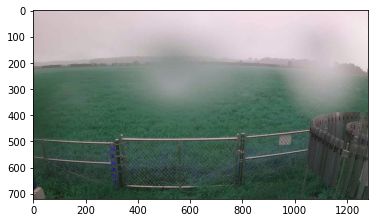

59 /ai2es/cam_photos/2017/07/13/BATA/20170713T142526_BATA.jpg
day light


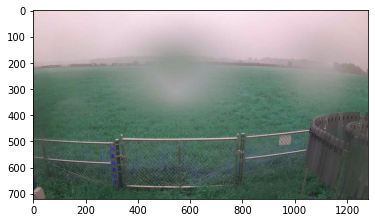

60 /ai2es/cam_photos/2017/07/20/BATA/20170720T172526_BATA.jpg
day light


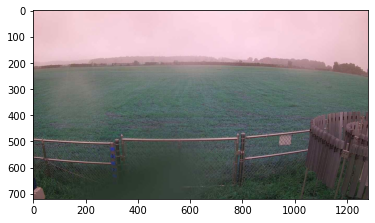

61 /ai2es/cam_photos/2017/07/24/BATA/20170724T160027_BATA.jpg
day light


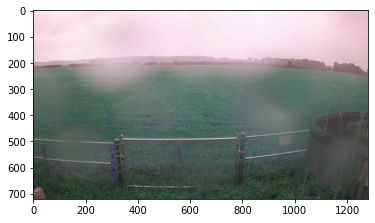

62 /ai2es/cam_photos/2017/08/03/BATA/20170803T205026_BATA.jpg
day light


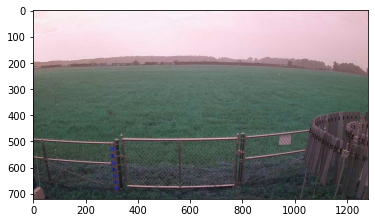

63 /ai2es/cam_photos/2017/08/04/BATA/20170804T111027_BATA.jpg
day light


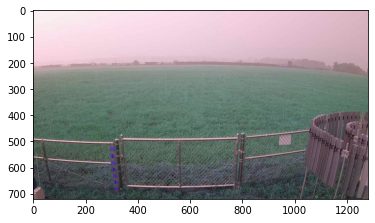

64 /ai2es/cam_photos/2017/08/04/BATA/20170804T185528_BATA.jpg
day light


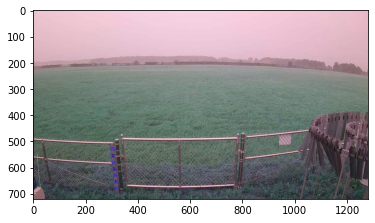

65 /ai2es/cam_photos/2017/08/15/BATA/20170815T185527_BATA.jpg
day light


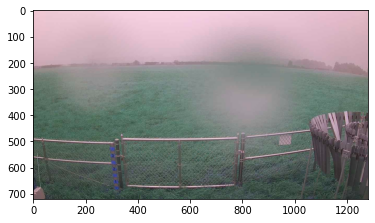

66 /ai2es/cam_photos/2017/08/22/BATA/20170822T164527_BATA.jpg
day light


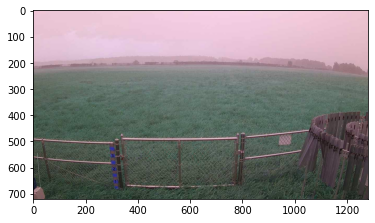

67 /ai2es/cam_photos/2017/09/03/BATA/20170903T184026_BATA.jpg
day light


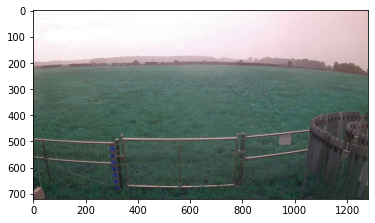

68 /ai2es/cam_photos/2017/11/05/BATA/20171105T110027_BATA.jpg
night light


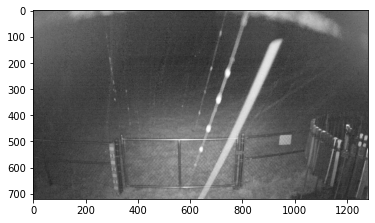

69 /ai2es/cam_photos/2017/05/05/BEAC/20170505T171501_BEAC.jpg
day light


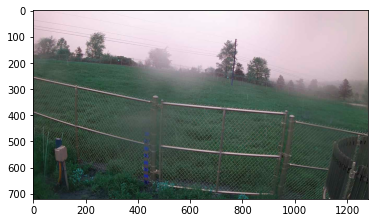

70 /ai2es/cam_photos/2017/05/07/BEAC/20170507T002502_BEAC.jpg
night light


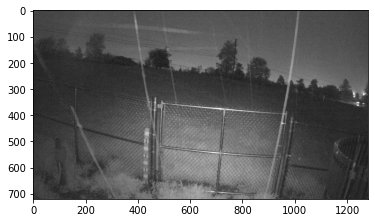

71 /ai2es/cam_photos/2017/06/13/BEAC/20170613T193526_BEAC.jpg
day light


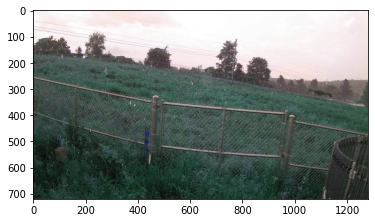

72 /ai2es/cam_photos/2017/06/19/BEAC/20170619T164526_BEAC.jpg
day light


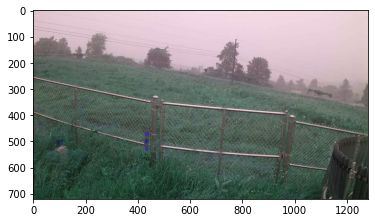

73 /ai2es/cam_photos/2017/06/19/BEAC/20170619T165026_BEAC.jpg
day light


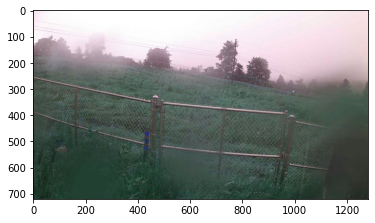

74 /ai2es/cam_photos/2017/06/19/BEAC/20170619T202526_BEAC.jpg
day light


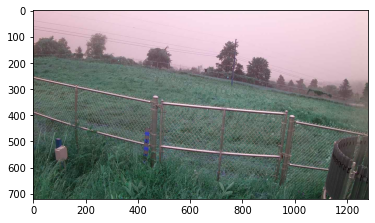

75 /ai2es/cam_photos/2017/06/30/BEAC/20170630T210526_BEAC.jpg
day light


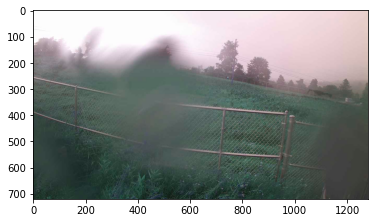

76 /ai2es/cam_photos/2017/07/08/BEAC/20170708T210026_BEAC.jpg
day light


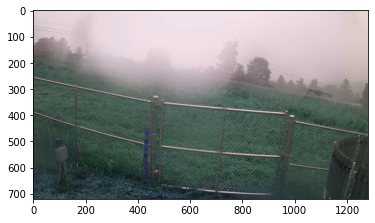

77 /ai2es/cam_photos/2017/07/12/BEAC/20170712T223027_BEAC.jpg
day light


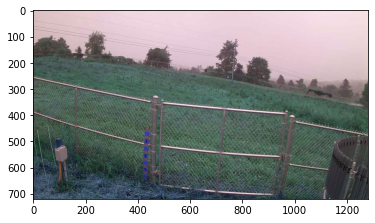

78 /ai2es/cam_photos/2017/07/12/BEAC/20170712T223526_BEAC.jpg
day light


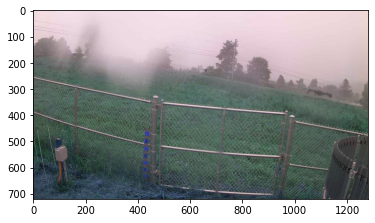

79 /ai2es/cam_photos/2017/07/12/BEAC/20170712T224026_BEAC.jpg
day light


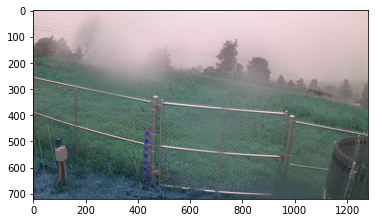

80 /ai2es/cam_photos/2017/07/12/BEAC/20170712T224526_BEAC.jpg
day light


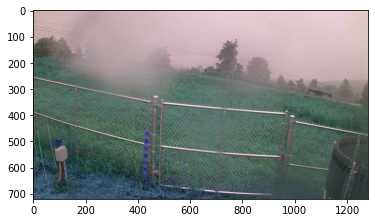

81 /ai2es/cam_photos/2017/07/13/BEAC/20170713T200027_BEAC.jpg
day light


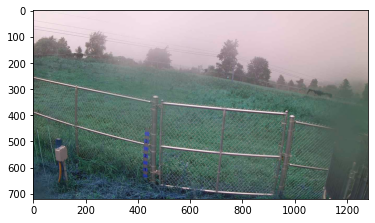

82 /ai2es/cam_photos/2017/07/20/BEAC/20170720T231026_BEAC.jpg
day light


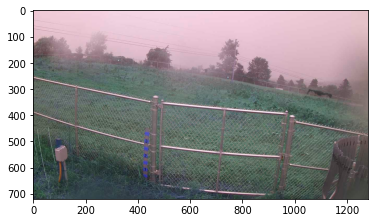

83 /ai2es/cam_photos/2017/07/20/BEAC/20170720T231526_BEAC.jpg
day light


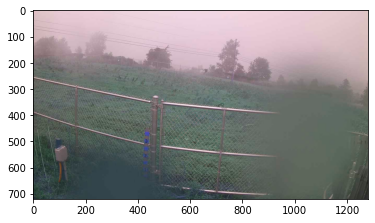

84 /ai2es/cam_photos/2017/08/02/BEAC/20170802T204027_BEAC.jpg
day light


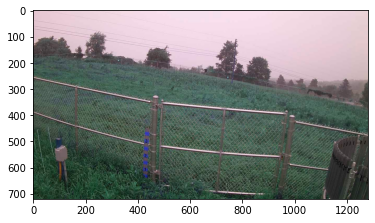

85 /ai2es/cam_photos/2017/08/18/BEAC/20170818T224027_BEAC.jpg
day light


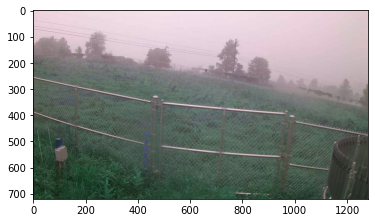

86 /ai2es/cam_photos/2017/08/18/BEAC/20170818T224526_BEAC.jpg
day light


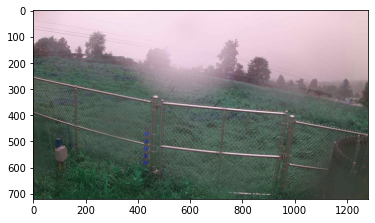

87 /ai2es/cam_photos/2017/09/05/BEAC/20170905T195527_BEAC.jpg
day light


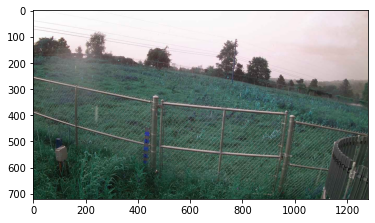

88 /ai2es/cam_photos/2017/04/20/BELD/20170420T234502_BELD.jpg
day light


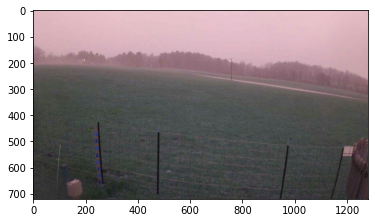

89 /ai2es/cam_photos/2017/05/02/BELD/20170502T001002_BELD.jpg
night light


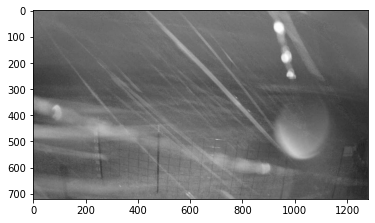

90 /ai2es/cam_photos/2017/05/02/BELD/20170502T001502_BELD.jpg
night light


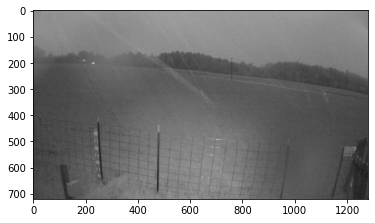

91 /ai2es/cam_photos/2017/05/19/BELD/20170519T002502_BELD.jpg
day light


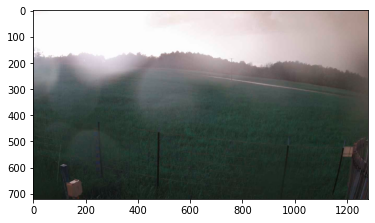

92 /ai2es/cam_photos/2017/05/30/BELD/20170530T125001_BELD.jpg
day light


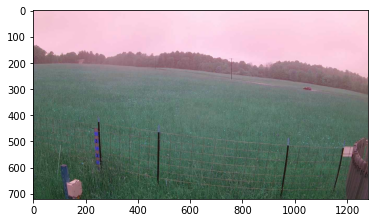

93 /ai2es/cam_photos/2017/05/30/BELD/20170530T131001_BELD.jpg
day light


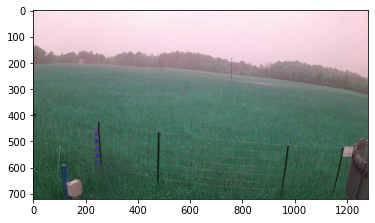

94 /ai2es/cam_photos/2017/06/05/BELD/20170605T200027_BELD.jpg
day light


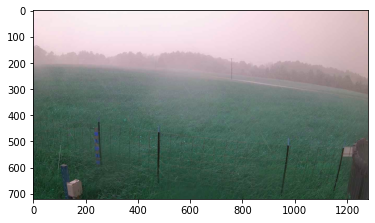

95 /ai2es/cam_photos/2017/06/05/BELD/20170605T211027_BELD.jpg
day light


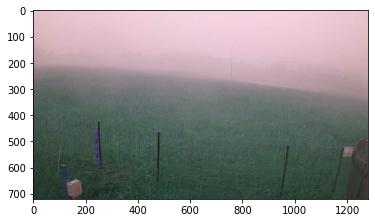

96 /ai2es/cam_photos/2017/06/05/BELD/20170605T211527_BELD.jpg
day light


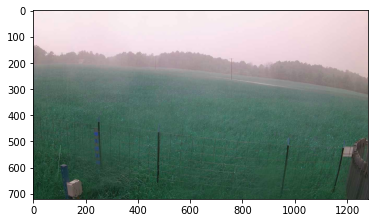

97 /ai2es/cam_photos/2017/06/05/BELD/20170605T212026_BELD.jpg
day light


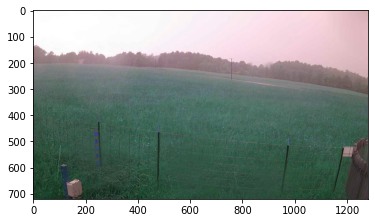

98 /ai2es/cam_photos/2017/06/05/BELD/20170605T212527_BELD.jpg
day light


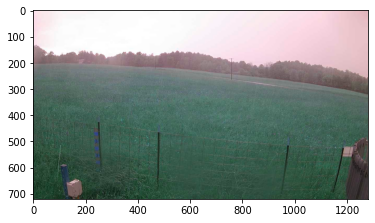

99 /ai2es/cam_photos/2017/06/19/BELD/20170619T174026_BELD.jpg
day light


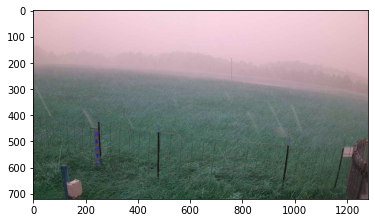

In [28]:
time_of_day(df)

797 images


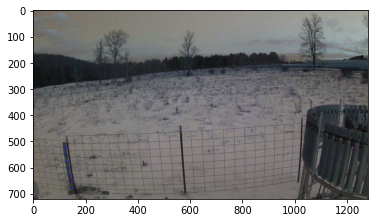

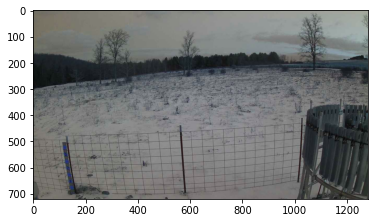

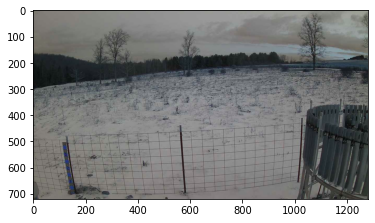

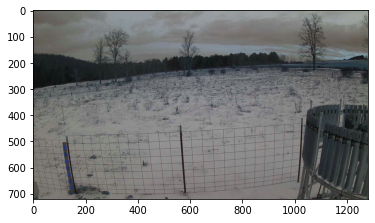

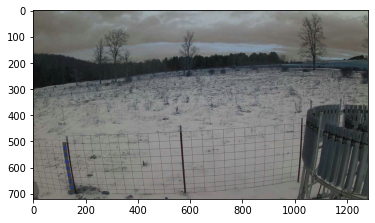

...

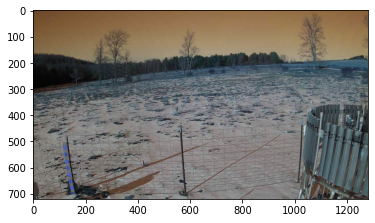

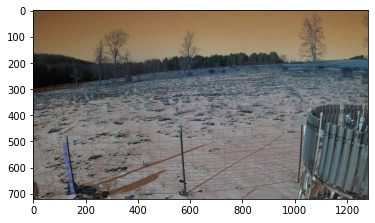

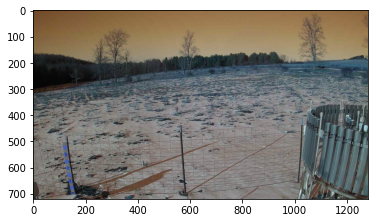

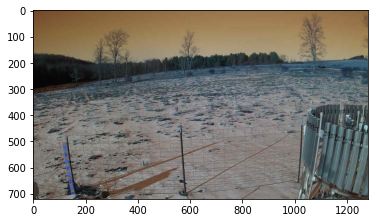

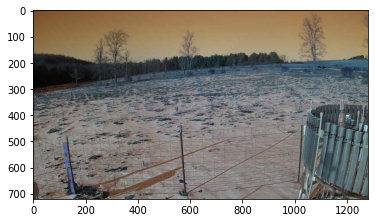

In [4]:
df = pd.read_parquet('/ai2es/matched_parquet/2017_timeofday.parquet')
df = df[df['night'] == False]
print(f'{len(df)} images')
for img in df["path"][:100]:
    image = cv2.imread(img)
    plt.imshow(image)
    plt.show()